# Efficient SAM Transfer Learning Analysis

### Resolving Dependencies

In [ ]:
%pip install nibabel -q
%pip install scikit-image -q
%pip install monai tqdm scikit-image matplotlib -q
!git clone https://github.com/yformer/EfficientSAM.git

### Importing Libraries

In [1]:
import os
import json
import glob
import torch
import zipfile
import functools
import numpy as np
import nibabel as nib
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torch.utils.data import Subset
from torch.utils.data import Dataset
from skimage.transform import resize
from torch.utils.data import DataLoader
from tqdm import tqdm # For progress bar
from sklearn.model_selection import KFold
os.chdir("/rhome/abhar061/shared/adv_cv/final_project/EfficientSAM")
from efficient_sam.build_efficient_sam import build_efficient_sam_vitt, build_efficient_sam_vits

### Loading model weights

In [2]:
# VITT Model
efficient_sam_vitt_model = build_efficient_sam_vitt()
efficient_sam_vitt_model.eval()
print(efficient_sam_vitt_model)

# VITS Model
with zipfile.ZipFile("weights/efficient_sam_vits.pt.zip", 'r') as zip_ref:
    zip_ref.extractall("weights")
    
efficient_sam_vits_model = build_efficient_sam_vits()
efficient_sam_vits_model.eval()
print(efficient_sam_vits_model)

EfficientSam(
  (image_encoder): ImageEncoderViT(
    (patch_embed): PatchEmbed(
      (proj): Conv2d(3, 192, kernel_size=(16, 16), stride=(16, 16))
    )
    (blocks): ModuleList(
      (0-11): 12 x Block(
        (norm1): LayerNorm((192,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=192, out_features=576, bias=True)
          (proj): Linear(in_features=192, out_features=192, bias=True)
        )
        (norm2): LayerNorm((192,), eps=1e-06, elementwise_affine=True)
        (mlp): Mlp(
          (fc1): Linear(in_features=192, out_features=768, bias=True)
          (act): GELU(approximate='none')
          (fc2): Linear(in_features=768, out_features=192, bias=True)
        )
      )
    )
    (neck): Sequential(
      (0): Conv2d(192, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (1): LayerNorm2d()
      (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (3): LayerNorm2d()
    )
 

### Loading Dataset

Medical Segmentation Decathlon (MSD): It comprises 10 distinct 3D segmentation tasks from various anatomical sites and imaging modalities (e.g., liver, brain, prostate, cardiac, lung, pancreas). It's designed to be a benchmark for general-purpose medical image segmentation, making it ideal for testing a generalist model like EfficientSAM. Many of these tasks have not been extensively explored with SAM-like models.

#### Task 1 : Brain Tumor

In [ ]:
os.makedirs("/tmp/abhar061/acv-final", exist_ok=True) # Create directory if it doesn't exist
os.chdir("/tmp/abhar061/acv-final") # cd /tmp/abhar061/acv-final
!wget https://msd-for-monai.s3-us-west-2.amazonaws.com/Task01_BrainTumour.tar

In [ ]:
!tar -xf Task01_BrainTumour.tar -C /tmp/abhar061/acv-final

##### Note : Here we don't have labels for the test set, so we will need to use a validation set for evaluation.

### Data Loading and Preprocessing

In [17]:
# --- Simple NIfTI loader without caching ---
def load_nifti(path: str):
    return nib.load(path).get_fdata()

class BraTSDataset(Dataset):
    def __init__(self, image_paths, label_paths, image_size=(256, 256), num_points=1, seed=42):
        self.image_paths = image_paths
        self.label_paths = label_paths
        self.image_size = image_size
        self.num_points = num_points
        self.rng = np.random.default_rng(seed)

        assert len(self.image_paths) == len(self.label_paths), "Mismatch in number of image and label paths."

    def __len__(self):
        return len(self.image_paths) * 2  # Light duplication to increase randomness

    def __getitem__(self, idx):
        volume_idx = idx // 2
        slice_offset = idx % 2

        image_volume = load_nifti(self.image_paths[volume_idx])  # (H, W, D, C)
        label_volume = load_nifti(self.label_paths[volume_idx])  # (H, W, D)

        slice_idx = None
        
        # Find slices with any foreground
        valid_slices = np.any(label_volume > 0, axis=(0, 1))
        if np.any(valid_slices):
            possible_idxs = np.where(valid_slices)[0]
            slice_idx = self.rng.choice(possible_idxs)
        else:
            # fallback to random
            slice_idx = self.rng.integers(label_volume.shape[2])

        # Extract and process image
        image_slice = image_volume[:, :, slice_idx, :].astype(np.float32)  # (H, W, C)
        image_slice_avg = np.mean(image_slice, axis=-1)
        image_tensor = torch.from_numpy(image_slice_avg).unsqueeze(0).unsqueeze(0)  # (1, 1, H, W)
        image_resized = F.interpolate(image_tensor, size=self.image_size, mode='bilinear', align_corners=False).squeeze(0)
        image_tensor = image_resized.repeat(3, 1, 1)  # (3, H, W)

        # Extract and process label
        label_slice = label_volume[:, :, slice_idx].astype(np.float32)

        label_tensor = torch.from_numpy(label_slice).unsqueeze(0).unsqueeze(0)  # (1, 1, H, W)
        label_resized = F.interpolate(label_tensor, size=self.image_size, mode='nearest').squeeze(0)
        binary_mask = (label_resized > 0).float()
        label_tensor = binary_mask.unsqueeze(0)  # (1, H, W)

        # Sample points from mask
        point_coords, point_labels = [], []
        fg_indices = torch.nonzero(binary_mask > 0, as_tuple=False)
        bg_indices = torch.nonzero(binary_mask == 0, as_tuple=False)

        if fg_indices.numel() > 0:
            sampled_fg = self.rng.choice(fg_indices.shape[0], min(self.num_points, fg_indices.shape[0]), replace=False)
            for i in sampled_fg:
                _, y, x = fg_indices[i].tolist()
                point_coords.append([x, y])
                point_labels.append(1)

        if bg_indices.numel() > 0:
            sampled_bg = self.rng.choice(bg_indices.shape[0], min(self.num_points, bg_indices.shape[0]), replace=False)
            for i in sampled_bg:
                _, y, x = bg_indices[i].tolist()
                point_coords.append([x, y])
                point_labels.append(0)

        # Format prompt point tensors
        if point_coords:
            coords_tensor = torch.tensor(point_coords, dtype=torch.float32).unsqueeze(0)  # (1, N, 2)
            labels_tensor = torch.tensor(point_labels, dtype=torch.float32).unsqueeze(0)  # (1, N)
        else:
            coords_tensor = torch.empty((1, 0, 2), dtype=torch.float32)
            labels_tensor = torch.empty((1, 0), dtype=torch.float32)

        return image_tensor, coords_tensor, labels_tensor, label_tensor

In [18]:
def efficient_sam_collate_fn(batch):
    images, coords, labels, masks = zip(*batch)  # batch is a list of tuples

    images = torch.stack(images)       # (B, 3, H, W)
    masks = torch.stack(masks)         # (B, 1, H, W)

    # Pad point coords and labels to the max length in this batch
    max_points = max(c.shape[1] for c in coords)

    padded_coords = []
    padded_labels = []
    for c, l in zip(coords, labels):
        pad_len = max_points - c.shape[1]
        if pad_len > 0:
            c = F.pad(c, (0, 0, 0, pad_len), value=-1.0)  # Pad along point dim
            l = F.pad(l, (0, pad_len), value=-1.0)
        padded_coords.append(c)
        padded_labels.append(l)

    coords_tensor = torch.stack(padded_coords)  # (B, 1, max_points, 2)
    labels_tensor = torch.stack(padded_labels)  # (B, 1, max_points)

    return images, coords_tensor, labels_tensor, masks

Dataset length: 968


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1294.2095].


Image Tensor shape: torch.Size([3, 256, 256])
Point Coords Tensor shape: torch.Size([1, 4, 2])
Point Labels Tensor shape: torch.Size([1, 4])
Ground Truth Mask Tensor shape: torch.Size([1, 1, 256, 256])
Point Coords (x,y): [[146.0, 169.0], [146.0, 172.0], [20.0, 220.0], [0.0, 110.0]]
Point coordinates are within image bounds.


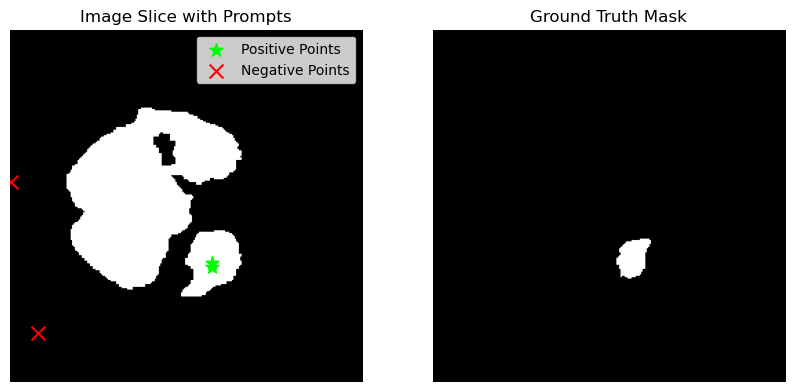

In [19]:
os.chdir("/rhome/abhar061/shared/adv_cv/final_project/EfficientSAM")
DATA_ROOT = '/tmp/abhar061/acv-final/Task01_BrainTumour'

# --- File loading ---
all_images = sorted(glob.glob(os.path.join(DATA_ROOT, 'imagesTr', '*.nii.gz')))
all_labels = sorted(glob.glob(os.path.join(DATA_ROOT, 'labelsTr', '*.nii.gz')))

try:
    all_images = sorted(glob.glob(os.path.join(DATA_ROOT, 'imagesTr', '*.nii.gz')))
    all_labels = sorted(glob.glob(os.path.join(DATA_ROOT, 'labelsTr', '*.nii.gz')))

    dataset = BraTSDataset(image_paths=all_images, label_paths=all_labels, image_size=(256, 256), num_points=2)

    print(f"Dataset length: {len(dataset)}")
    img_tensor, coords_tensor, labels_tensor, gt_mask_tensor = dataset[69] # Get the 69th sample

    print(f"Image Tensor shape: {img_tensor.shape}")
    print(f"Point Coords Tensor shape: {coords_tensor.shape}") # Should be (1, num_points, 2)
    print(f"Point Labels Tensor shape: {labels_tensor.shape}") # Should be (1, num_points)
    print(f"Ground Truth Mask Tensor shape: {gt_mask_tensor.shape}") # Should be (1, H, W)

    # Verify point coordinates are within bounds
    H, W = img_tensor.shape[1], img_tensor.shape[2]
    if coords_tensor.numel() > 0:
        print(f"Point Coords (x,y): {coords_tensor.squeeze().tolist()}")
        x_coords = coords_tensor.squeeze()[:, 0]
        y_coords = coords_tensor.squeeze()[:, 1]
        if torch.any(x_coords < 0) or torch.any(x_coords >= W) or \
            torch.any(y_coords < 0) or torch.any(y_coords >= H):
            print("WARNING: Generated point coordinates are out of image bounds!")
        else:
            print("Point coordinates are within image bounds.")

    # Optional: Visualize a slice and its points/mask
    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(img_tensor.permute(1, 2, 0).numpy()) # Convert (C, H, W) to (H, W, C) for imshow
    if coords_tensor.numel() > 0:
        # EfficientSAM coordinates are (x,y) which map to (col, row)
        # For plotting, we need (row, col) = (y, x)
        points_for_plot = coords_tensor.squeeze().numpy()
        positive_points = points_for_plot[labels_tensor.squeeze().long() == 1]
        negative_points = points_for_plot[labels_tensor.squeeze().long() == 0]

        if positive_points.size > 0:
            plt.scatter(positive_points[:, 0], positive_points[:, 1], c='lime', marker='*', s=100, label='Positive Points')
        if negative_points.size > 0:
            plt.scatter(negative_points[:, 0], negative_points[:, 1], c='red', marker='x', s=100, label='Negative Points')
    plt.title('Image Slice with Prompts')
    plt.axis('off')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.imshow(gt_mask_tensor.squeeze().numpy(), cmap='gray')
    plt.title('Ground Truth Mask')
    plt.axis('off')

    plt.show()

except Exception as e:
    print(f"Error during dataset test: {e}")
    print("Please ensure your data_root is correct and dataset.json/NIfTI files exist.")

#### Performs Point Segmentation, Need to Implement Box Segmentation

### Sample Visualization 

Image shape: (240, 240, 155, 4), Label shape: (240, 240, 155)


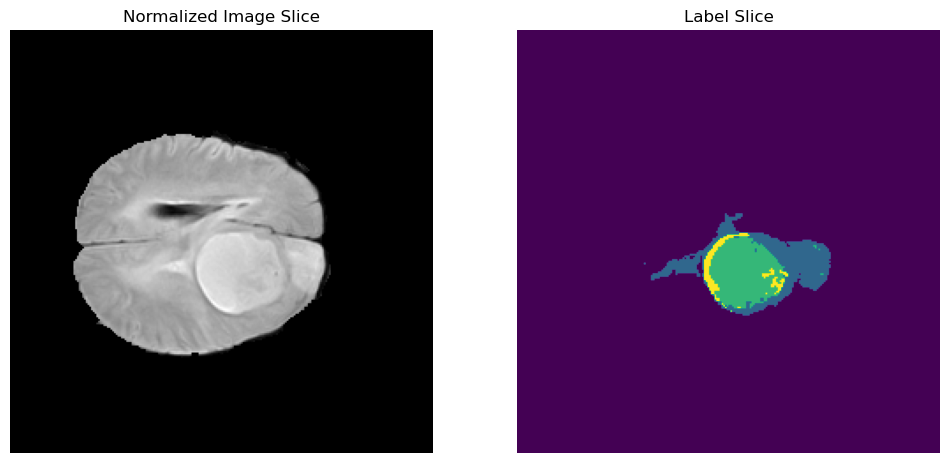

In [20]:
# Reading and displaying a sample image and label
file_number = 79
nib_image = nib.load(dataset.image_paths[file_number])
nib_label = nib.load(dataset.label_paths[file_number])
print(f"Image shape: {nib_image.shape}, Label shape: {nib_label.shape}")

# Displaying a single slice of the image and label
image_data = nib_image.get_fdata()
label_data = nib_label.get_fdata()

# Normalizing the image and label 

slice_index = 90  # Change this to view different slices

# Normalizing the image data for better visualization
image_data_norm = (image_data - image_data.min()) / (image_data.max() - image_data.min())

# Displaying the normalized image and label
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(image_data_norm[:, :, slice_index, 0], cmap='gray')  # Displaying the first modality
plt.title('Normalized Image Slice')
plt.axis('off')

plt.subplot(1, 2, 2)
# Explicitly setting vmin and vmax for label_data
# Assuming 0 is background, and 1, 2, 3 are distinct foreground labels
plt.imshow(label_data[:, :, slice_index], cmap='viridis', vmin=0, vmax=3)
plt.title('Label Slice')
plt.axis('off')

plt.show()

In [21]:
label_data.max(), label_data.min(), np.unique(label_data)
# label_data.shape
slice_index = 80
len(label_data[:, :, slice_index][label_data[:, :, slice_index] > 0]), label_data[:, :, slice_index].shape

(2212, (240, 240))

### Utility Functions

In [22]:
def dice_loss(outputs, targets, smooth=1e-6):
    """
    Computes the Dice Loss.
    Args:
        outputs (torch.Tensor): Predicted logits from the model (N, 1, H, W).
        targets (torch.Tensor): Ground truth binary masks (N, 1, H, W).
        smooth (float): A small constant to prevent division by zero.
    Returns:
        torch.Tensor: Dice Loss.
    """
    # Apply sigmoid to convert logits to probabilities
    outputs = torch.sigmoid(outputs)

    # Flatten label and prediction tensors
    outputs = outputs.view(-1)
    targets = targets.view(-1)

    intersection = (outputs * targets).sum()
    dice = (2. * intersection + smooth) / (outputs.sum() + targets.sum() + smooth)
    return 1 - dice

def get_mask_from_logits(logits, threshold=0.0):
    """
    Converts model output logits to a binary mask.
    Args:
        logits (torch.Tensor): Logits from the model (N, 1, H, W).
        threshold (float): Threshold for binarization after sigmoid.
    Returns:
        torch.Tensor: Binary mask (N, 1, H, W) of type float32.
    """
    probs = torch.sigmoid(logits)
    binary_mask = (probs > threshold).float()
    return binary_mask

def show_mask(mask, ax, random_color=False):
    """Utility for visualizing masks (from SAM's original notebook)."""
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=375):
    """Utility for visualizing points (from SAM's original notebook)."""
    pos_points = coords[labels == 1]
    neg_points = coords[labels == 0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='x', s=marker_size, edgecolor='white', linewidth=1.25)

def show_box(box, ax):
    """Utility for visualizing bounding boxes (from SAM's original notebook)."""
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))


### Training the Model

In [23]:
os.makedirs("/tmp/abhar061/acv-final/checkpoints", exist_ok=True)

In [ ]:
import gc
import torch

gc.collect()
torch.cuda.empty_cache()
torch.cuda.reset_peak_memory_stats()

# --- Configuration ---
DATA_ROOT = '/tmp/abhar061/acv-final/Task01_BrainTumour'
CHECKPOINT_DIR = '/tmp/abhar061/acv-final/checkpoints'
IMAGE_SIZE = (256, 256)
NUM_POINTS_PER_PROMPT = 2
BATCH_SIZE = 1  # Reduced for stability
LEARNING_RATE = 1e-4
NUM_EPOCHS = 5
VALIDATION_FREQ = 1
SAVE_FREQ = 1  # Save every epoch for now

os.makedirs(CHECKPOINT_DIR, exist_ok=True)

# --- Device Setup ---
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

# --- File loading ---
all_images = sorted(glob.glob(os.path.join(DATA_ROOT, 'imagesTr', '*.nii.gz')))
all_labels = sorted(glob.glob(os.path.join(DATA_ROOT, 'labelsTr', '*.nii.gz')))
assert len(all_images) == len(all_labels)

# --- Train/Validation Split ---
from sklearn.model_selection import train_test_split
train_images, val_images, train_labels, val_labels = train_test_split(
    all_images, all_labels, test_size=0.2, random_state=42
)

train_dataset = BraTSDataset(train_images, train_labels, image_size=IMAGE_SIZE, num_points=NUM_POINTS_PER_PROMPT, seed=42)
val_dataset = BraTSDataset(val_images, val_labels, image_size=IMAGE_SIZE, num_points=NUM_POINTS_PER_PROMPT, seed=123)

train_subset = Subset(train_dataset, list(range(min(1000, len(train_dataset)))))
val_subset = Subset(val_dataset, list(range(min(250, len(val_dataset)))))

train_loader = DataLoader(train_subset, batch_size=BATCH_SIZE, shuffle=True, num_workers=0, pin_memory=(device.type == 'cuda'), persistent_workers=False, collate_fn=efficient_sam_collate_fn)
val_loader = DataLoader(val_subset, batch_size=BATCH_SIZE, shuffle=False, num_workers=0, pin_memory=(device.type == 'cuda'), persistent_workers=False, collate_fn=efficient_sam_collate_fn)

# --- Model, Loss, Optimizer, Scheduler ---
model = build_efficient_sam_vitt()
model.to(device)

bce_loss_fn = nn.BCEWithLogitsLoss()
combined_loss_fn = lambda outputs, targets: bce_loss_fn(outputs, targets) + dice_loss(outputs, targets)

optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5)
best_val_loss = float('inf')

train_losses, val_losses = [], []
val_dice_scores, val_all_preds, val_all_targets = [], [], []

for epoch in range(NUM_EPOCHS):
    model.train()
    running_loss = 0.0
    train_loop = tqdm(train_loader, desc=f"Epoch {epoch+1}/{NUM_EPOCHS} [Train]")

    for image_tensor, point_coords_tensor, point_labels_tensor, gt_mask_tensor in train_loop:
        image_tensor = image_tensor.to(device)
        point_coords_tensor = point_coords_tensor.to(device)
        point_labels_tensor = point_labels_tensor.to(device)
        gt_mask_tensor = gt_mask_tensor.to(device)

        # Skip if no points in this sample
        if point_coords_tensor.shape[1] == 0:
            continue

        optimizer.zero_grad()
        image_embeddings = model.get_image_embeddings(image_tensor)

        B, _, H, W = image_tensor.shape

        # [B, N, 2] -> [B, 1, N, 2]
        if point_coords_tensor.ndim == 3:
            point_coords_tensor = point_coords_tensor.unsqueeze(1)
        if point_labels_tensor.ndim == 2:
            point_labels_tensor = point_labels_tensor.unsqueeze(1)

        pred_masks, _ = model.predict_masks(
            image_embeddings, 
            point_coords_tensor, 
            point_labels_tensor, 
            multimask_output=False, 
            input_h=H, 
            input_w=W
        )

        # Select primary prediction
        pred_masks = pred_masks[:, 0, 0].unsqueeze(1)  # [B, 1, H, W]

        # Make sure ground truth is also [B, 1, H, W]
        if gt_mask_tensor.ndim == 5 and gt_mask_tensor.shape[2] == 1:
            gt_mask_tensor = gt_mask_tensor.squeeze(2)  # (B, 1, H, W)

        loss = combined_loss_fn(pred_masks, gt_mask_tensor)

        if torch.isnan(loss):
            print("NaN loss encountered. Skipping batch.")
            continue

        loss.backward()
        optimizer.step()
        running_loss += loss.item()
        train_loop.set_postfix(loss=f"{loss.item():.4f}")

    avg_train_loss = running_loss / len(train_loader)
    train_losses.append(avg_train_loss)
    print(f"Epoch {epoch+1} Train Loss: {avg_train_loss:.4f}")

    # --- Validation ---
    if (epoch + 1) % VALIDATION_FREQ == 0:
        model.eval()
        val_running_loss = 0.0
        val_dice_batch = []

        val_loop = tqdm(val_loader, desc=f"Epoch {epoch+1} [Val]")
        with torch.no_grad():
            for image_tensor, point_coords_tensor, point_labels_tensor, gt_mask_tensor in val_loop:
                image_tensor = image_tensor.to(device)
                point_coords_tensor = point_coords_tensor.to(device)
                point_labels_tensor = point_labels_tensor.to(device)
                gt_mask_tensor = gt_mask_tensor.to(device)

                if point_coords_tensor.shape[1] == 0:
                    continue

                image_embeddings = model.get_image_embeddings(image_tensor)
                B, _, H, W = image_tensor.shape

                # [B, N, 2] -> [B, 1, N, 2]
                if point_coords_tensor.ndim == 3:
                    point_coords_tensor = point_coords_tensor.unsqueeze(1)
                if point_labels_tensor.ndim == 2:
                    point_labels_tensor = point_labels_tensor.unsqueeze(1)

                pred_masks, _ = model.predict_masks(
                    image_embeddings, 
                    point_coords_tensor, 
                    point_labels_tensor, 
                    multimask_output=False, 
                    input_h=H, 
                    input_w=W
                )

                pred_masks = pred_masks[:, 0, 0].unsqueeze(1)  # [B, 1, H, W]

                if gt_mask_tensor.ndim == 5 and gt_mask_tensor.shape[2] == 1:
                    gt_mask_tensor = gt_mask_tensor.squeeze(2)  # (B, 1, H, W)

                loss = combined_loss_fn(pred_masks, gt_mask_tensor)
                if torch.isnan(loss):
                    continue

                val_running_loss += loss.item()

                predicted_binary_mask = get_mask_from_logits(pred_masks, threshold=0.0)
                intersection = (predicted_binary_mask * gt_mask_tensor).sum(dim=(-1, -2))
                union = predicted_binary_mask.sum(dim=(-1, -2)) + gt_mask_tensor.sum(dim=(-1, -2))
                batch_dice = (2. * intersection + 1e-6) / (union + 1e-6)
                val_dice_batch.extend(batch_dice.cpu().numpy())

                # Collect predictions and targets
                val_all_preds.extend(pred_masks.sigmoid().detach().cpu().numpy().ravel())
                val_all_targets.extend(gt_mask_tensor.detach().cpu().numpy().ravel())

                val_loop.set_postfix(val_loss=f"{loss.item():.4f}")

        avg_val_loss = val_running_loss / len(val_loader)
        avg_val_dice = np.mean(val_dice_batch)
        val_losses.append(avg_val_loss)
        val_dice_scores.append(avg_val_dice)

        print(f"Val Loss: {avg_val_loss:.4f}, Avg Dice: {avg_val_dice:.4f}")
        scheduler.step(avg_val_loss)

        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            torch.save(model.state_dict(), os.path.join(CHECKPOINT_DIR, f'efficient_sam_vitt_best.pt'))

    if (epoch + 1) % SAVE_FREQ == 0:
        torch.save(model.state_dict(), os.path.join(CHECKPOINT_DIR, f'efficient_sam_vitt_epoch_{epoch + 1}.pt'))

    # Free memory
    del image_tensor, point_coords_tensor, point_labels_tensor, gt_mask_tensor, pred_masks, loss
    torch.cuda.empty_cache()

# --- Save Metrics ---
np.savez(
    os.path.join(CHECKPOINT_DIR, "training_metrics.npz"),
    train_losses=np.array(train_losses),
    val_losses=np.array(val_losses),
    val_dice_scores=np.array(val_dice_scores),
    val_all_preds=np.array(val_all_preds),
    val_all_targets=np.array(val_all_targets),
)

print("\n Training Complete")
print(f"Best Val Loss: {best_val_loss:.4f}, Best Dice: {max(val_dice_scores):.4f}")

Using device: cuda


Epoch 1/5 [Train]: 100%|██████████| 774/774 [07:09<00:00,  1.80it/s, loss=0.7024]


Epoch 1 Train Loss: 0.6613


Epoch 1 [Val]: 100%|██████████| 194/194 [01:37<00:00,  1.98it/s, val_loss=0.6094]


Val Loss: 0.5832, Avg Dice: 0.0465


Epoch 2/5 [Train]: 100%|██████████| 774/774 [07:18<00:00,  1.76it/s, loss=0.4307]


Epoch 2 Train Loss: 0.6121


Epoch 2 [Val]: 100%|██████████| 194/194 [01:35<00:00,  2.03it/s, val_loss=0.4121]


Val Loss: 0.5894, Avg Dice: 0.0499


Epoch 3/5 [Train]: 100%|██████████| 774/774 [07:08<00:00,  1.80it/s, loss=0.6934]


Epoch 3 Train Loss: 0.5679


Epoch 3 [Val]: 100%|██████████| 194/194 [01:35<00:00,  2.02it/s, val_loss=0.3979]


Val Loss: 0.5860, Avg Dice: 0.0451


Epoch 4/5 [Train]: 100%|██████████| 774/774 [07:11<00:00,  1.79it/s, loss=0.2878]


Epoch 4 Train Loss: 0.5779


Epoch 4 [Val]: 100%|██████████| 194/194 [01:34<00:00,  2.05it/s, val_loss=0.2389]


Val Loss: 0.5455, Avg Dice: 0.0496


Epoch 5/5 [Train]: 100%|██████████| 774/774 [07:09<00:00,  1.80it/s, loss=0.5508]


Epoch 5 Train Loss: 0.5734


Epoch 5 [Val]: 100%|██████████| 194/194 [01:35<00:00,  2.03it/s, val_loss=0.2619]


Val Loss: 0.5646, Avg Dice: 0.0460

📊 Training Complete
Best Val Loss: 0.5455, Best Dice: 0.0499


In [ ]:
# Saving the model state
torch.save(model.state_dict(), os.path.join(CHECKPOINT_DIR, 'efficient_sam_vitt_final.pt'))

### Plotting

In [27]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import (
    roc_auc_score, roc_curve, confusion_matrix,
    ConfusionMatrixDisplay, classification_report
)
import seaborn as sns

# Load metrics
data = np.load(os.path.join(CHECKPOINT_DIR, "training_metrics.npz"))

train_losses = data["train_losses"]
val_losses = data["val_losses"]
val_dice_scores = data["val_dice_scores"]
val_all_preds = data["val_all_preds"]
val_all_targets = data["val_all_targets"]

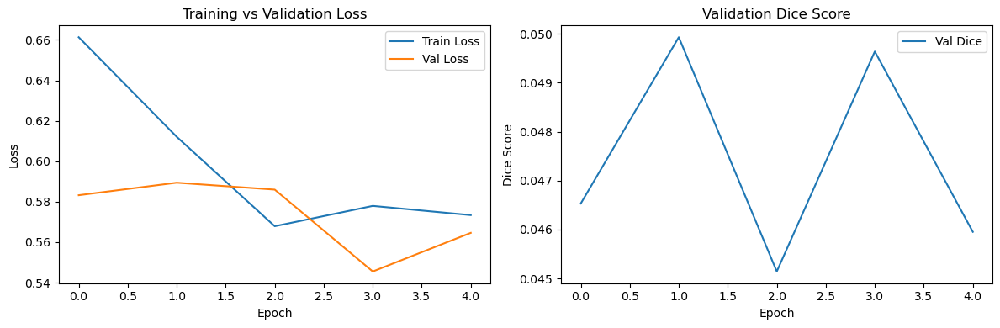

In [28]:
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.title("Training vs Validation Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(val_dice_scores, label="Val Dice")
plt.title("Validation Dice Score")
plt.xlabel("Epoch")
plt.ylabel("Dice Score")
plt.legend()

plt.tight_layout()
plt.show()

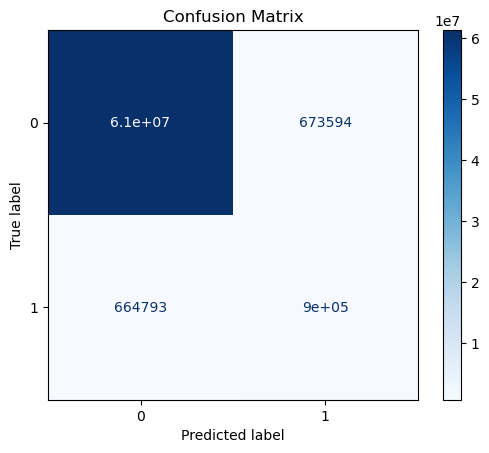

In [29]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Binarize predictions if they're probabilistic
threshold = 0.5
binary_preds = (val_all_preds >= threshold).astype(int)
binary_targets = val_all_targets.astype(int)

cm = confusion_matrix(binary_targets.flatten(), binary_preds.flatten())
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap="Blues")
plt.title("Confusion Matrix")
plt.show()

/opt/linux/rocky/8.x/x86_64/pkgs/miniconda3/py39_4.12.0/lib/python3.9/site-packages/IPython/core/pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


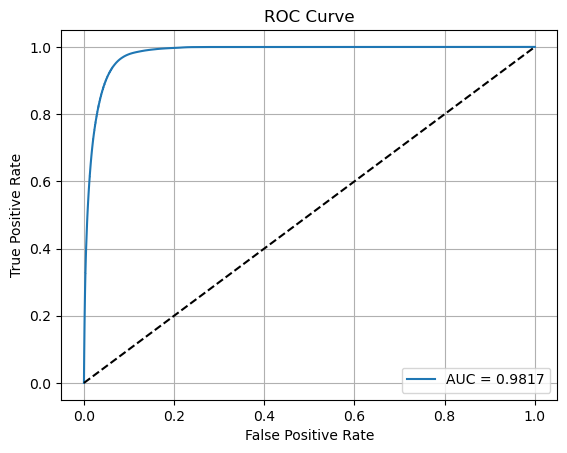

In [30]:
fpr, tpr, _ = roc_curve(binary_targets.flatten(), val_all_preds.flatten())
auc_score = roc_auc_score(binary_targets.flatten(), val_all_preds.flatten())

plt.figure()
plt.plot(fpr, tpr, label=f"AUC = {auc_score:.4f}")
plt.plot([0, 1], [0, 1], "k--")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve")
plt.legend()
plt.grid(True)
plt.show()

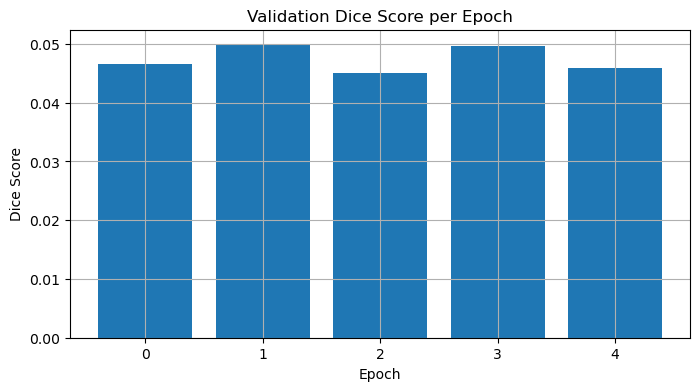

In [32]:
plt.figure(figsize=(8, 4))
plt.bar(np.arange(len(val_dice_scores)), val_dice_scores)
plt.title("Validation Dice Score per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Dice Score")
plt.grid(True)
plt.show()

In [33]:
print("Classification Report:\n")
print(classification_report(binary_targets.flatten(), binary_preds.flatten(), digits=4))

Classification Report:

              precision    recall  f1-score   support

           0     0.9893    0.9891    0.9892  62001863
           1     0.5728    0.5760    0.5744   1568057

    accuracy                         0.9789  63569920
   macro avg     0.7811    0.7826    0.7818  63569920
weighted avg     0.9790    0.9789    0.9790  63569920



#### Testing the Model

In [4]:
# --- Dataset class for test images only (no labels) ---
class BraTSTestDataset(Dataset):
    def __init__(self, image_paths, image_size=(256, 256), seed=42):
        self.image_paths = image_paths
        self.image_size = image_size
        self.rng = np.random.default_rng(seed)

    def _load_nifti(self, path):
        return nib.load(path).get_fdata()

    def __len__(self):
        return len(self.image_paths) * 10  # 10 slices per volume

    def __getitem__(self, idx):
        volume_idx = idx // 10
        slice_idx_offset = idx % 10

        image_volume = self._load_nifti(self.image_paths[volume_idx])
        num_slices = image_volume.shape[2]
        slice_idx = (self.rng.integers(num_slices) + slice_idx_offset) % num_slices

        image_slice = image_volume[:, :, slice_idx, :]
        image_slice_avg = np.mean(image_slice, axis=-1)

        min_val, max_val = image_slice_avg.min(), image_slice_avg.max()
        image_slice_norm = (image_slice_avg - min_val) / (max_val - min_val) if max_val > min_val else np.zeros_like(image_slice_avg)

        image_resized = resize(image_slice_norm, self.image_size, anti_aliasing=True, preserve_range=True)
        image_tensor = torch.from_numpy(image_resized).float().unsqueeze(0).repeat(3, 1, 1)  # (3, H, W)

        # Generate center point as prompt
        center_y, center_x = self.image_size[0] // 2, self.image_size[1] // 2
        coords_tensor = torch.tensor([[[center_x, center_y]]], dtype=torch.float32)  # (1, 1, 2)
        labels_tensor = torch.tensor([[1.]], dtype=torch.float32)  # foreground label

        return image_tensor, coords_tensor, labels_tensor, self.image_paths[volume_idx], slice_idx


In [42]:
def run_inference(model, dataloader, device, save_dir="./predictions"):
    model.eval()
    os.makedirs(save_dir, exist_ok=True)

    with torch.no_grad():
        for i, (img, pts, pt_labels, vol_path, slice_idx) in enumerate(dataloader):
            img = img.to(device)
            pts = pts.to(device)
            pt_labels = pt_labels.to(device)

            B, _, H, W = img.shape

            # Ensure pts: [B, 1, N, 2], pt_labels: [B, 1, N]
            if pts.ndim == 3:  # [B, N, 2]
                pts = pts.unsqueeze(1)
            if pt_labels.ndim == 2:  # [B, N]
                pt_labels = pt_labels.unsqueeze(1)

            embeddings = model.get_image_embeddings(img)
            masks, _ = model.predict_masks(embeddings, pts, pt_labels, False, H, W)
            masks = masks[:, 0, 0].unsqueeze(1)  # (B, 1, H, W)
            bin_mask = (masks.sigmoid() > 0.5).float()

            for j in range(B):
                img_np = img[j].permute(1, 2, 0).cpu().numpy()
                mask_np = bin_mask[j, 0].cpu().numpy()

                plt.figure(figsize=(10, 5))
                plt.subplot(1, 2, 1)
                plt.imshow(img_np, cmap='gray')
                plt.title('Input Image')
                plt.axis('off')

                plt.subplot(1, 2, 2)
                plt.imshow(img_np, cmap='gray')
                plt.imshow(mask_np, alpha=0.5, cmap='inferno')
                plt.title('Predicted Mask')
                plt.axis('off')
                plt.tight_layout()
                plt.show()
                single_vol_path = vol_path[j]
                single_slice_idx = slice_idx[j]

                vol_id = os.path.basename(single_vol_path)
                slice_num = int(single_slice_idx.item()) if isinstance(single_slice_idx, torch.Tensor) else int(single_slice_idx)

                plt.savefig(os.path.join(save_dir, f"{vol_id}_slice{slice_num}.png"))
                plt.close()

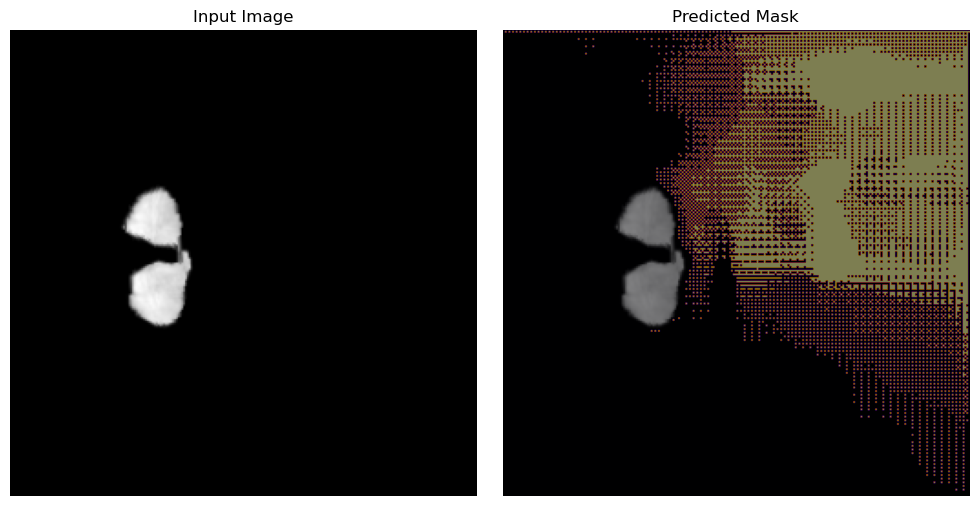

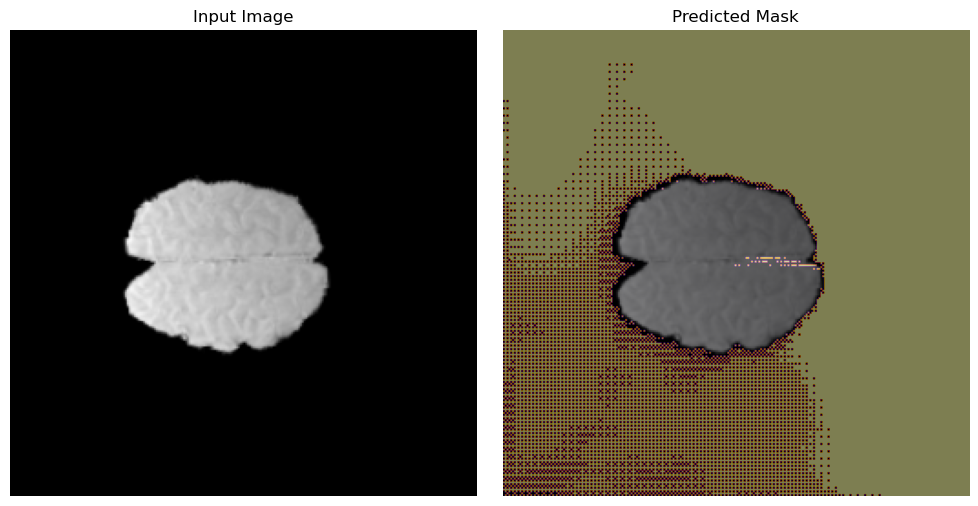

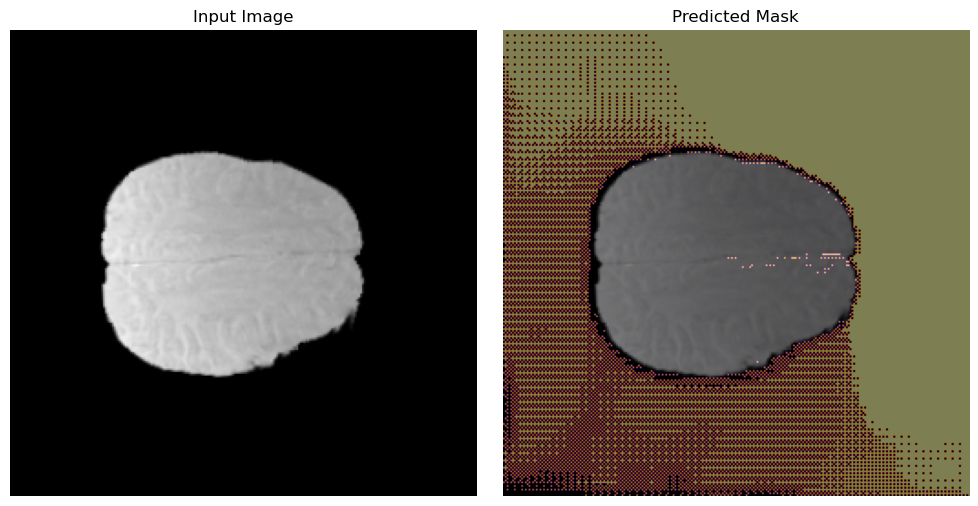

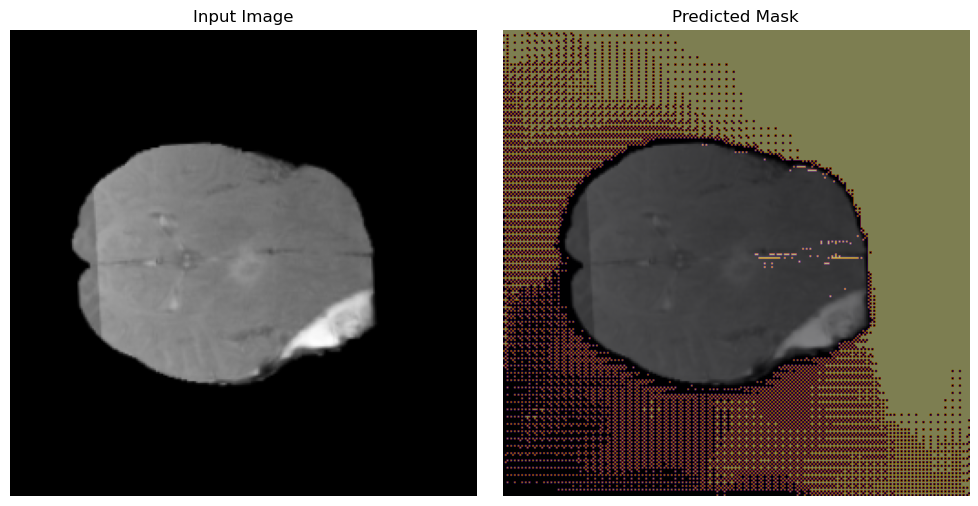

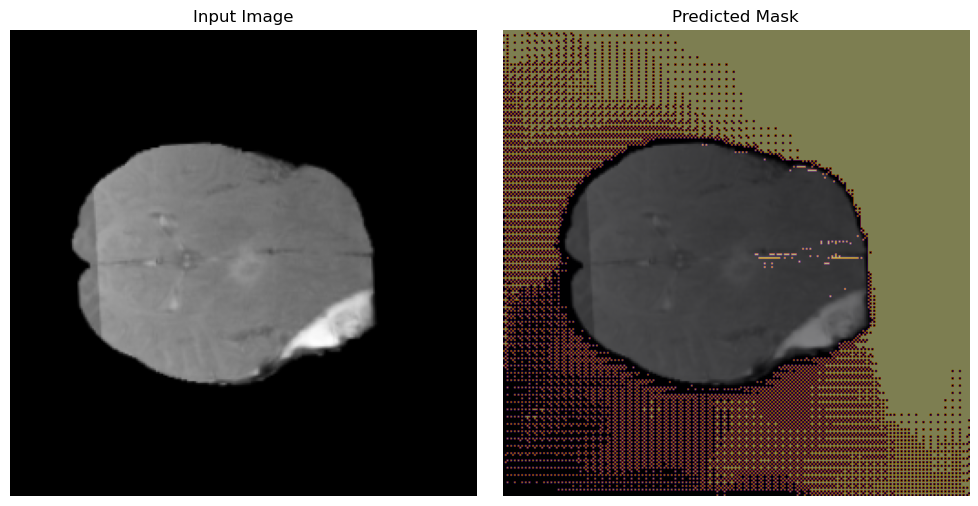

...

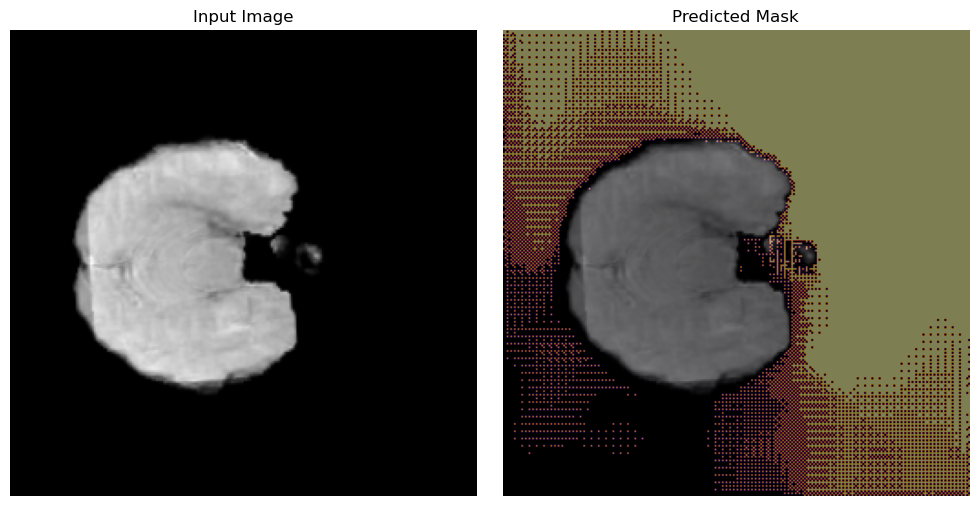

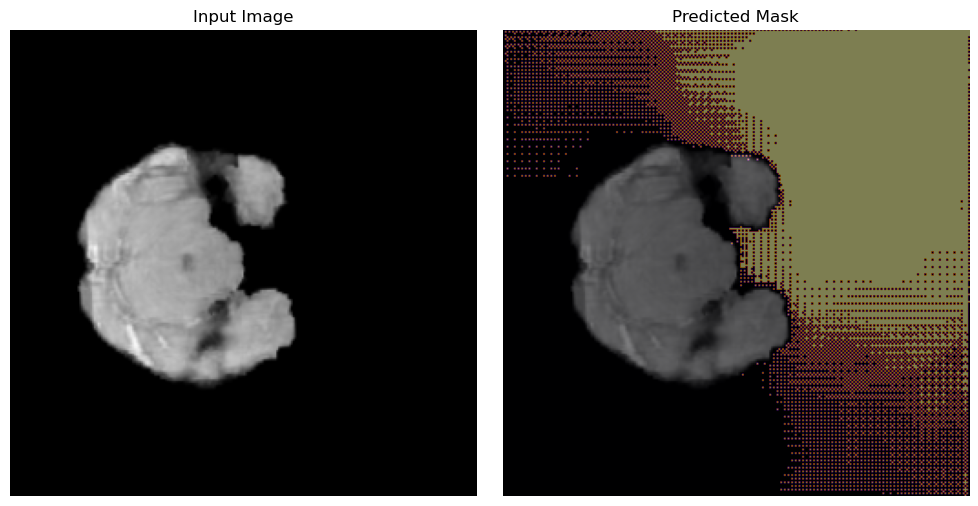

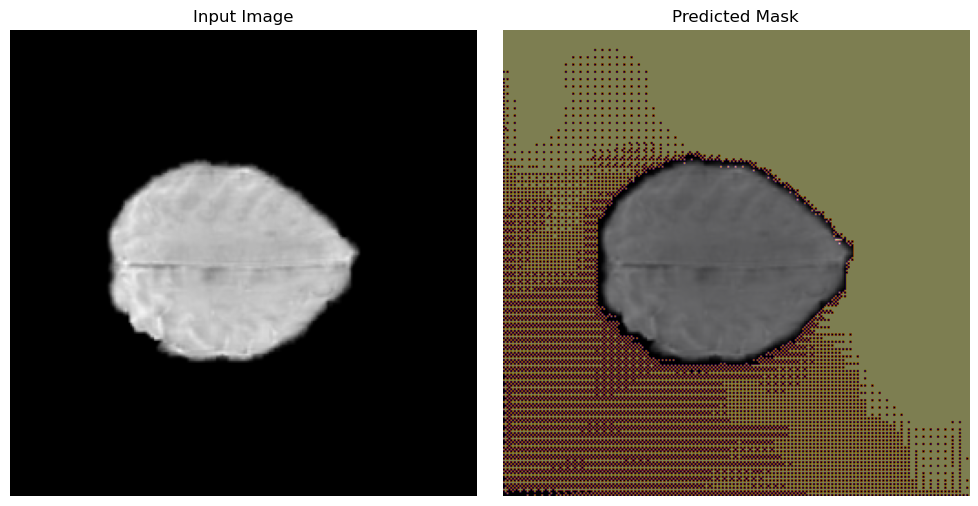

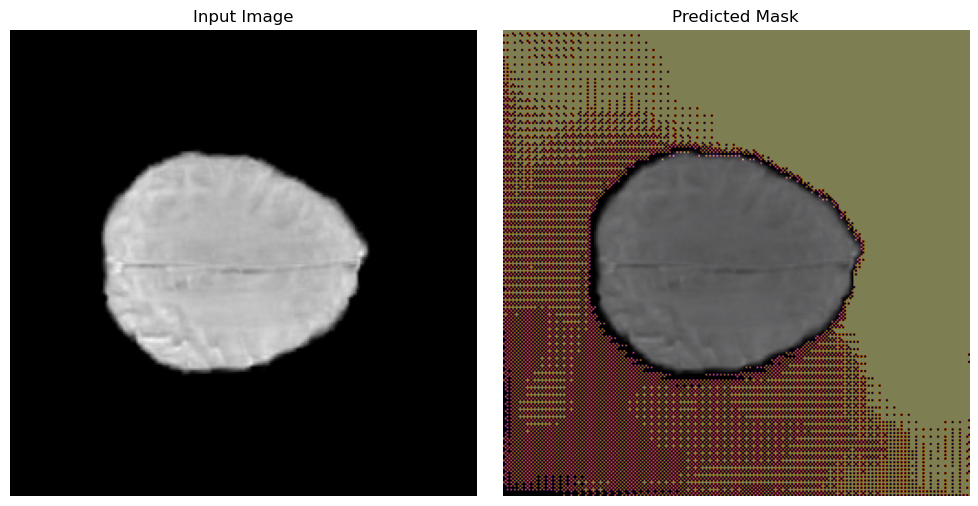

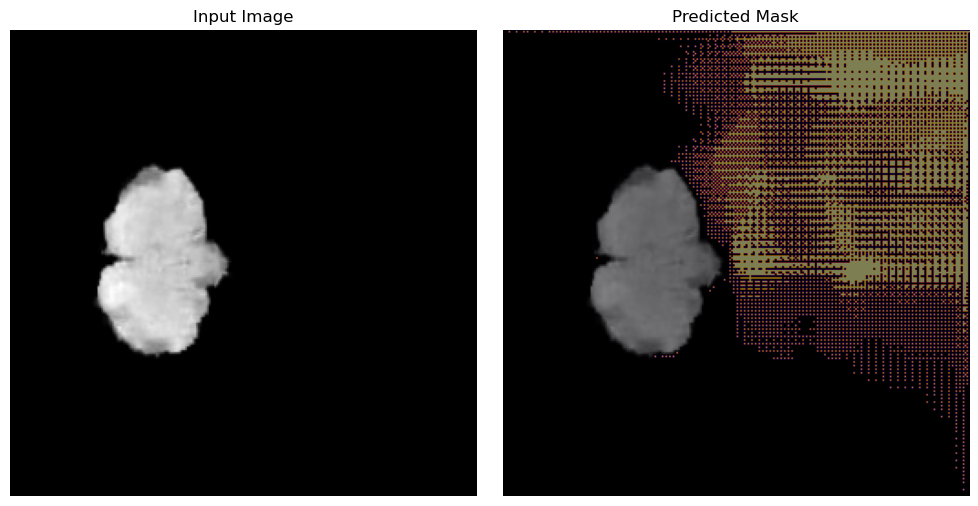

In [43]:
# --- Example Usage ---
TEST_DATA_ROOT = "/tmp/abhar061/acv-final/Task01_BrainTumour/imagesTs"
test_image_paths = sorted(glob.glob(os.path.join(TEST_DATA_ROOT, '*.nii.gz')))

test_dataset = BraTSTestDataset(test_image_paths)
test_subset = Subset(test_dataset, list(range(min(100, len(test_dataset)))))  # Limit to 100 samples for testing
test_loader = DataLoader(test_subset, batch_size=2, shuffle=False, num_workers=0)

model = build_efficient_sam_vitt()  # or load your trained checkpoint
# model.load_state_dict(torch.load("/tmp/abhar061/acv-final/checkpoints/efficient_sam_vitt_best.pt"))
model.to("cuda" if torch.cuda.is_available() else "cpu")

run_inference(model, test_loader, device=torch.device("cuda" if torch.cuda.is_available() else "cpu"))